In [1]:
import numpy as np
import pandas as pd
import datashader as ds
from datashader import transfer_functions as tf
from datashader.colors import inferno, viridis
from numba import jit
from math import sin, cos, sqrt, fabs

In [2]:
from datashader import utils

In [38]:
@jit(nopython=True)
def Clifford(x, y, a, b, c, d, *o):
    return sin(a * y) + c * cos(a * x), \
           sin(b * x) + d * cos(b * y)

In [159]:
@jit(nopython=True)
def Kiyohiro(x, y, a):
    t = 0.4 - (7 / (1 + x**2 + y**2))
    return 1 + a * (x * cos(t) - y * sin(t)), \
           a * (x * sin(t) + y * cos(t))

In [160]:
n=10000000

@jit(nopython=True)
def trajectory_coords(fn, x0, y0, a, n=n):
    x, y = np.zeros(n), np.zeros(n)
    x[0], y[0] = x0, y0
    for i in np.arange(n-1):
        x[i+1], y[i+1] = fn(x[i], y[i], a)
    return x,y

def trajectory(fn, x0, y0, a, n=n):
    x, y = trajectory_coords(fn, x0, y0, a, n)
    return pd.DataFrame(dict(x=x,y=y))

In [161]:
%%time
df = trajectory(Kiyohiro, 0, 0, 0.83)

CPU times: user 699 ms, sys: 163 ms, total: 862 ms
Wall time: 789 ms


In [162]:
df.tail()

,x,y
9999995,0.272023,-1.260233
9999996,0.034609,0.461626
9999997,0.712944,0.255396
9999998,0.468467,0.335512
9999999,0.779673,0.424490


In [163]:
%%time

cvs = ds.Canvas(plot_width = 3000, plot_height = 3000)
agg = cvs.points(df, 'x', 'y')
print(agg.values[:5,:5],"\n")

[[0 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]] 

CPU times: user 167 ms, sys: 9.46 ms, total: 176 ms
Wall time: 175 ms


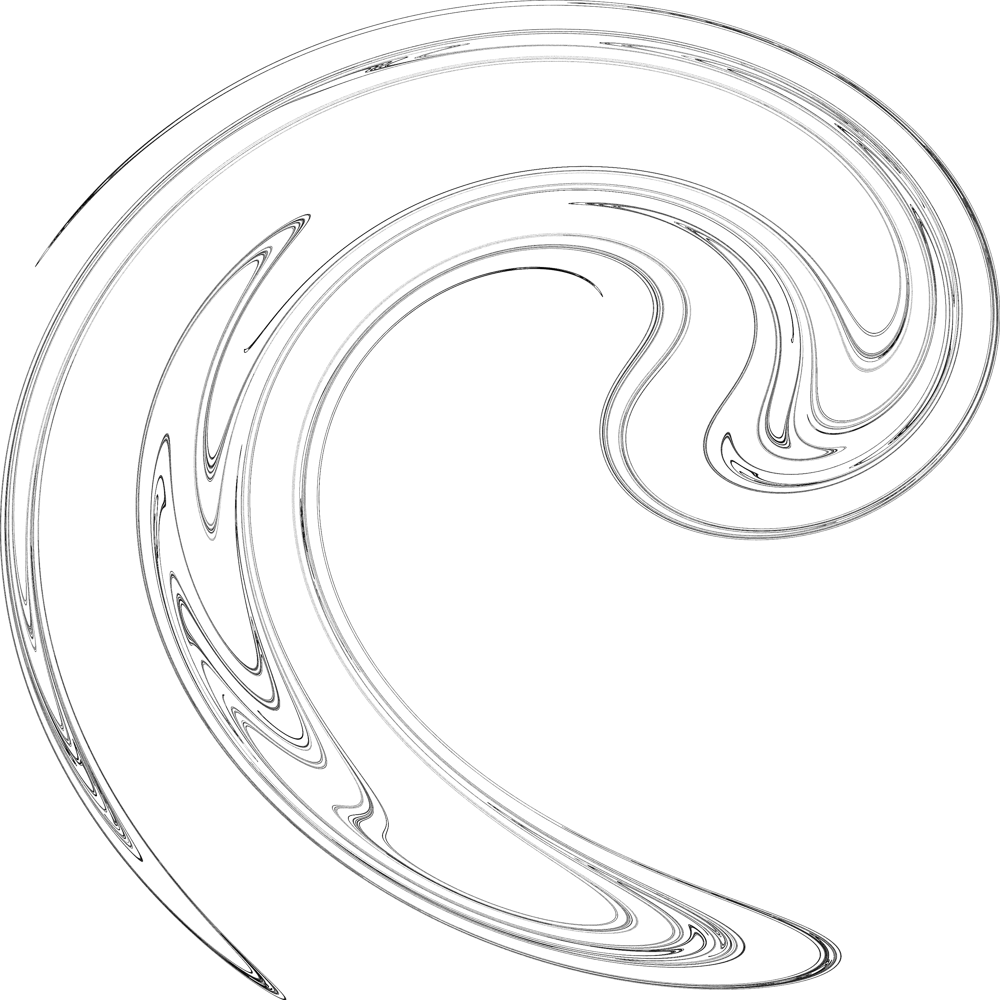

In [164]:
ds.transfer_functions.Image.border=0

tf.shade(agg, cmap = ["white", "black"])

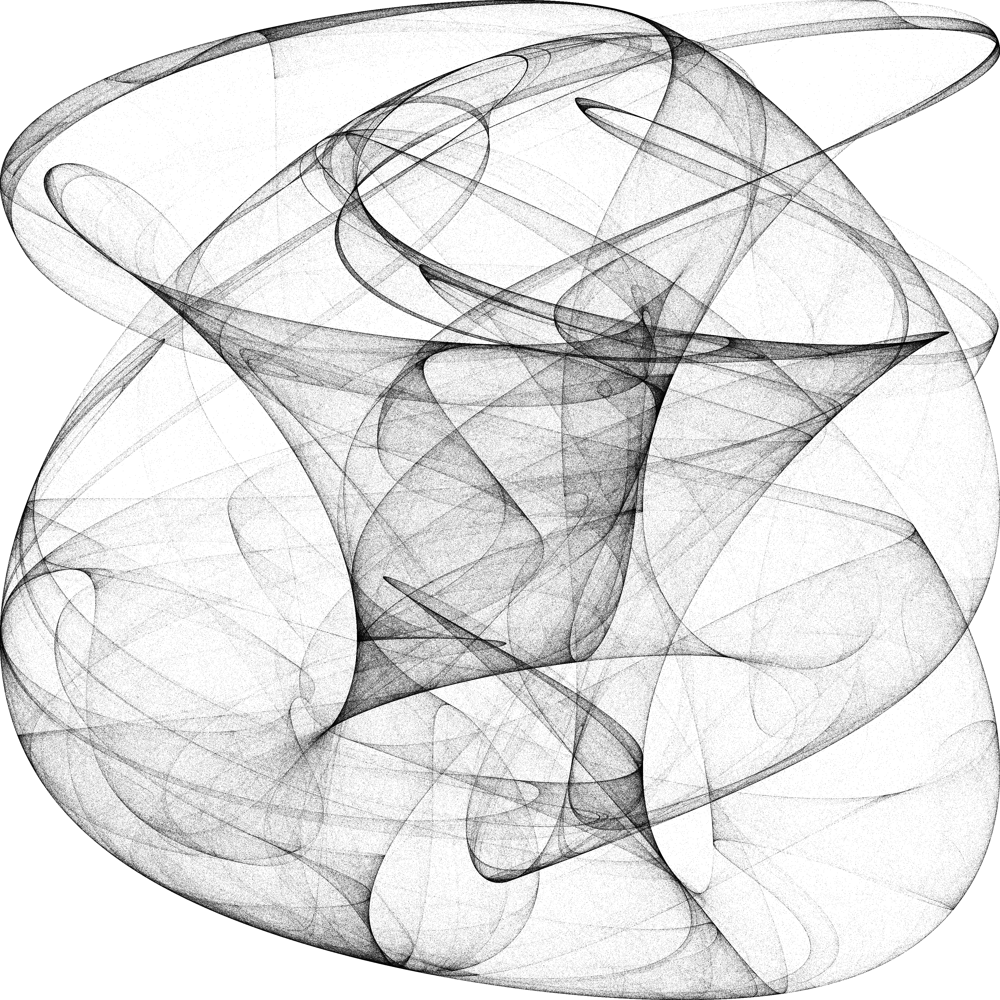

In [9]:
utils.export_image(img=a, filename='sample2', fmt=".png", background="white")

In [91]:
def dsplot(fn, vals, n=n, cmap=viridis, label=True):
    """Return a Datashader image by collecting `n` trajectory points for the given attractor `fn`"""
    lab = ("{}, "*(len(vals)-1)+" {}").format(*vals) if label else None
    df  = trajectory(fn, *vals, n=n)
    cvs = ds.Canvas(plot_width = 1000, plot_height = 1000)
    agg = cvs.points(df, 'x', 'y')
    img = tf.shade(agg, cmap=cmap, name=lab)
    return img

In [100]:
from colorcet import palette
viridis = palette["viridis"]
inferno = palette["inferno"]

In [103]:
vals

[['Clifford', 'bgy', 0, 0, -1.3, -1.3, -1.8, -1.9],
 ['Clifford', 'bmw', 0, 0, -1.4, 1.6, 1.0, 0.7],
 ['Clifford', 'bgyw', 0, 0, 1.7, 1.7, 0.6, 1.2],
 ['Clifford', 'bmy', 0, 0, 1.7, 0.7, 1.4, 2.0],
 ['Clifford', 'fire', 0, 0, -1.7, 1.8, -1.9, -0.4],
 ['Clifford', 'gray', 0, 0, 1.1, -1.32, -1.03, 1.54],
 ['Clifford', 'kgy', 0, 0, 0.77, 1.99, -1.31, -1.45],
 ['Clifford', 'kbc', 0, 0, -1.9, -1.9, -1.9, -1.0],
 ['Clifford', 'viridis', 0, 0, 0.75, 1.34, -1.93, 1.0],
 ['Clifford', 'inferno', 0, 0, -1.32, -1.65, 0.74, 1.81],
 ['Clifford', 'bgy', 0, 0, -1.6, 1.6, 0.7, -1.0],
 ['Clifford', 'bmw', 0, 0, -1.7, 1.5, -0.5, 0.7],
 ['De_Jong', 'kbc', 0, 0, -1.244, -1.251, -1.815, -1.908],
 ['De_Jong', 'viridis', 0, 0, 1.7, 1.7, 0.6, 1.2],
 ['De_Jong', 'inferno', 0, 0, 1.4, -2.3, 2.4, -2.1],
 ['De_Jong', 'bgy', 0, 0, -2.7, -0.09, -0.86, -2.2],
 ['De_Jong', 'bmw', 0, 0, -0.827, -1.637, 1.659, -0.943],
 ['De_Jong', 'bgyw', 0, 0, -2.24, 0.43, -0.65, -2.43],
 ['De_Jong', 'bmy', 0, 0, 2.01, -2.53, 1.61, -0

In [109]:
import yaml
vals = yaml.load(open("strange_attractors.yml","r"), Loader=yaml.FullLoader)

def args(name):
    """Return a list of available argument lists for the given type of attractor"""
    return [v[1:] for v in vals if v[0]==name]  

def plot(fn, vals=None, **kw):
    """Plot the given attractor `fn` once per provided set of arguments."""
    vargs=args(fn.__name__) if vals is None else vals
    return tf.Images(*[dsplot(fn, v[1:], cmap=palette[v[0]][::-1], **kw) for v in vargs]).cols(4)

In [112]:
args('Clifford')

[['bgy', 0, 0, -1.3, -1.3, -1.8, -1.9],
 ['bmw', 0, 0, -1.4, 1.6, 1.0, 0.7],
 ['bgyw', 0, 0, 1.7, 1.7, 0.6, 1.2],
 ['bmy', 0, 0, 1.7, 0.7, 1.4, 2.0],
 ['fire', 0, 0, -1.7, 1.8, -1.9, -0.4],
 ['gray', 0, 0, 1.1, -1.32, -1.03, 1.54],
 ['kgy', 0, 0, 0.77, 1.99, -1.31, -1.45],
 ['kbc', 0, 0, -1.9, -1.9, -1.9, -1.0],
 ['viridis', 0, 0, 0.75, 1.34, -1.93, 1.0],
 ['inferno', 0, 0, -1.32, -1.65, 0.74, 1.81],
 ['bgy', 0, 0, -1.6, 1.6, 0.7, -1.0],
 ['bmw', 0, 0, -1.7, 1.5, -0.5, 0.7]]

"0, 0, -1.3, -1.3, -1.8, -1.9","0, 0, -1.4, 1.6, 1.0, 0.7","0, 0, 1.7, 1.7, 0.6, 1.2","0, 0, 1.7, 0.7, 1.4, 2.0"
"0, 0, -1.7, 1.8, -1.9, -0.4","0, 0, 1.1, -1.32, -1.03, 1.54","0, 0, 0.77, 1.99, -1.31, -1.45","0, 0, -1.9, -1.9, -1.9, -1.0"
"0, 0, 0.75, 1.34, -1.93, 1.0","0, 0, -1.32, -1.65, 0.74, 1.81","0, 0, -1.6, 1.6, 0.7, -1.0","0, 0, -1.7, 1.5, -0.5, 0.7"

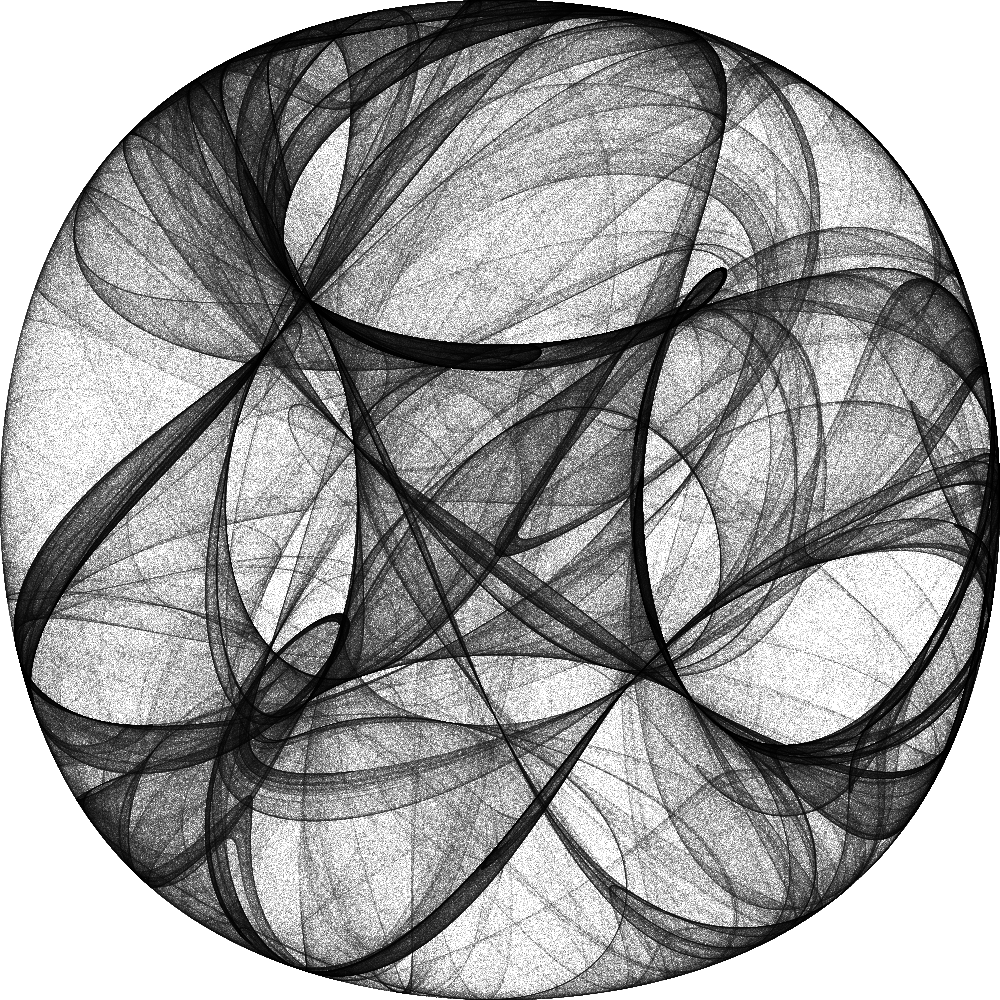
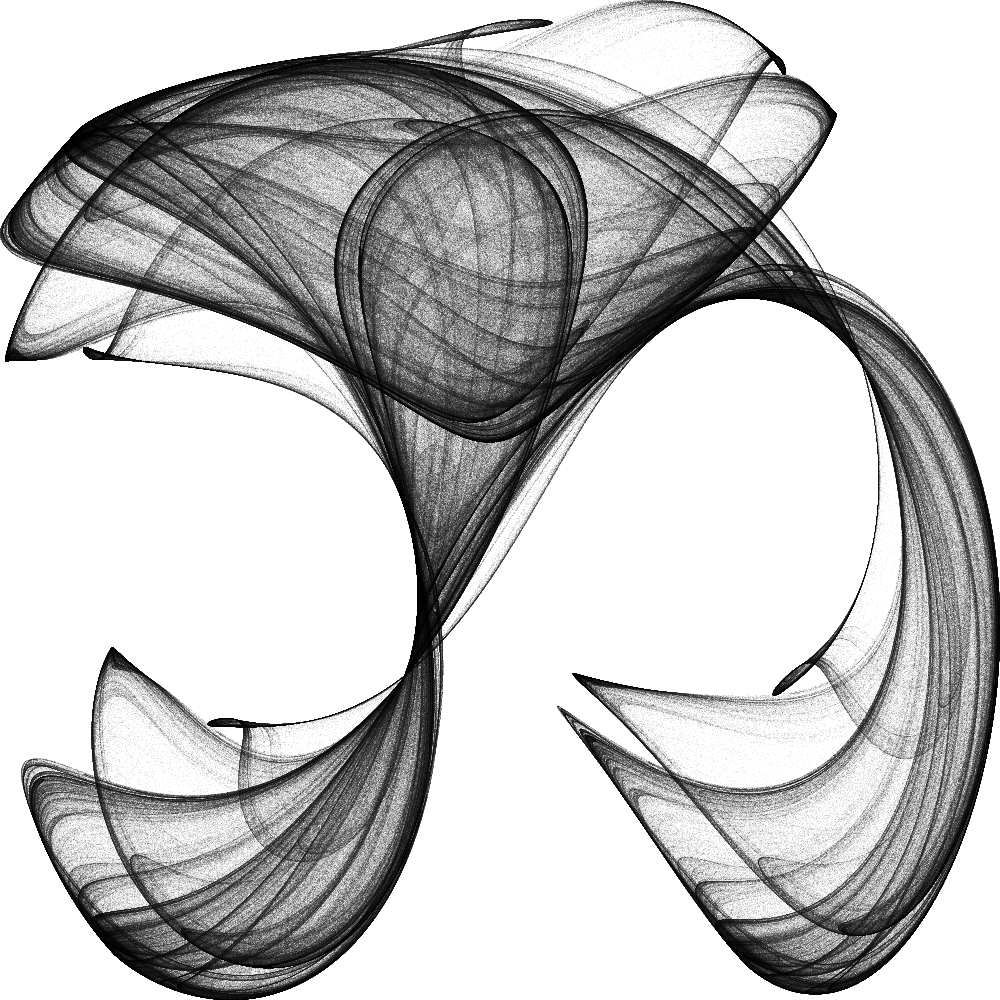
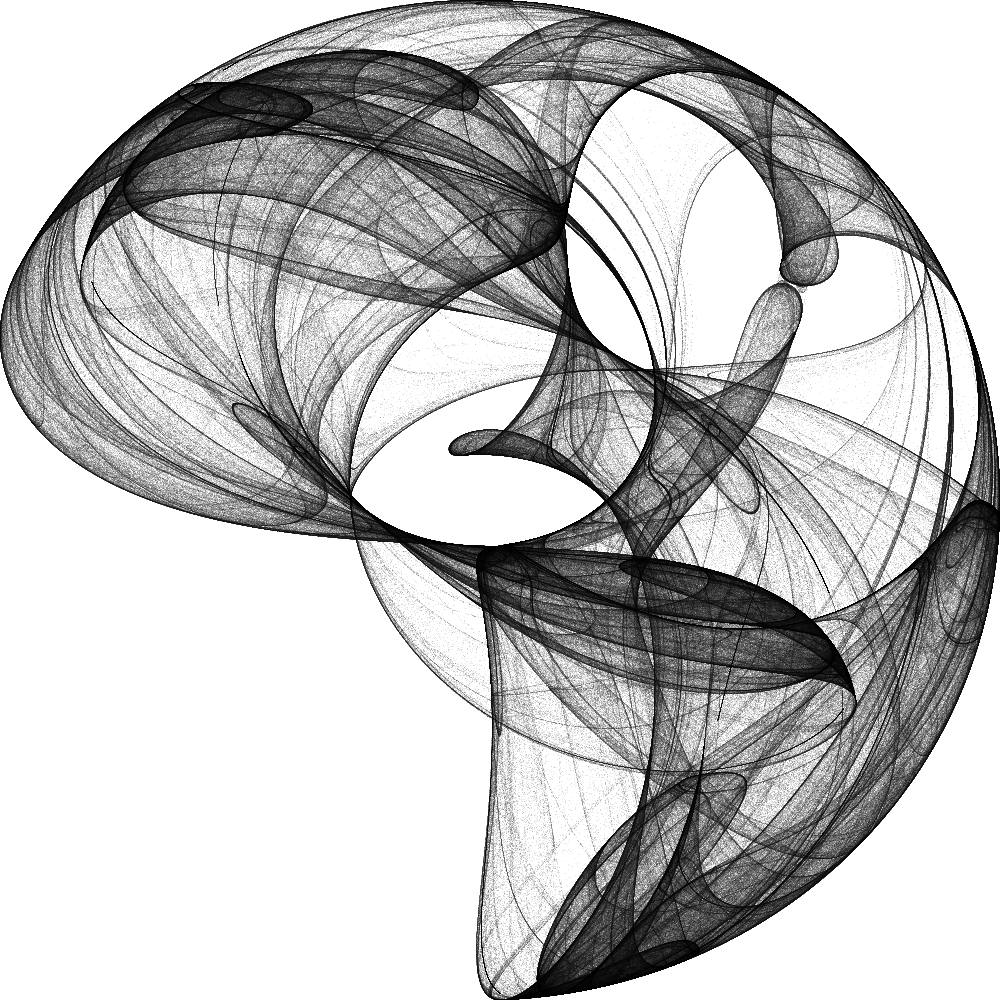
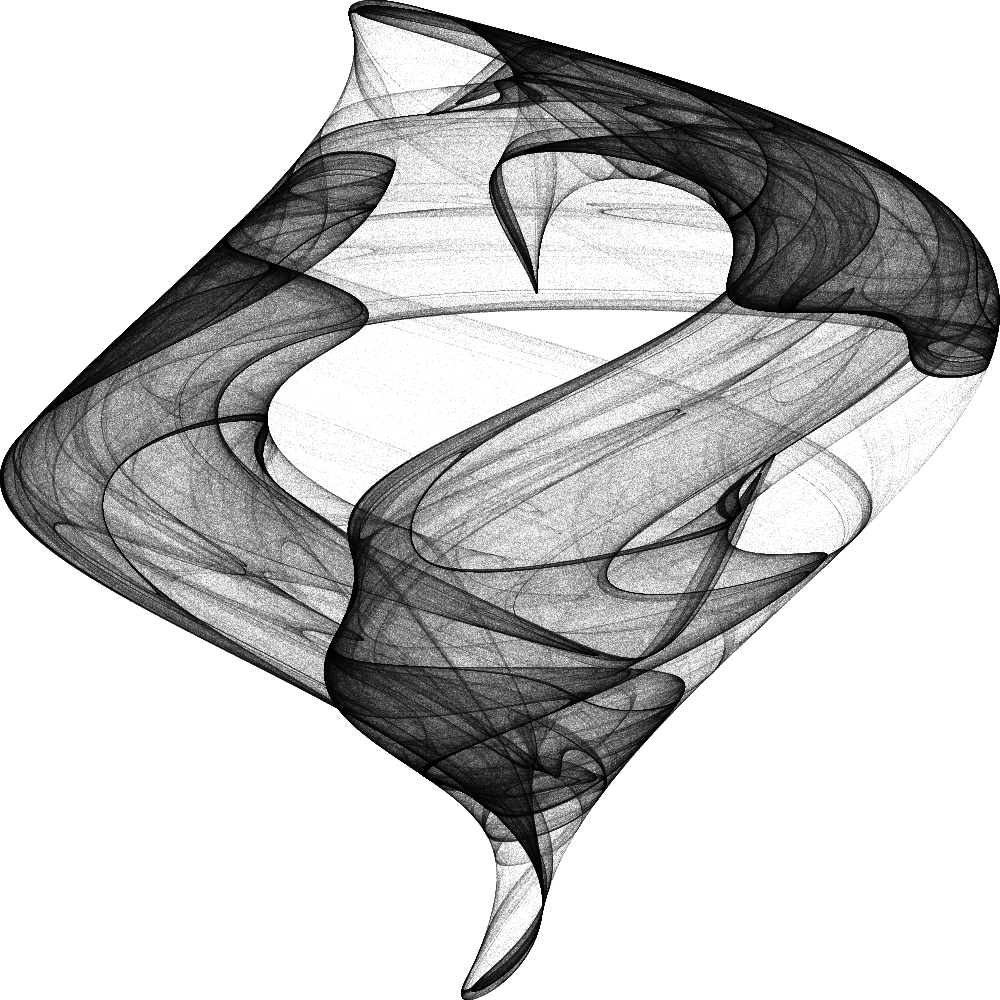
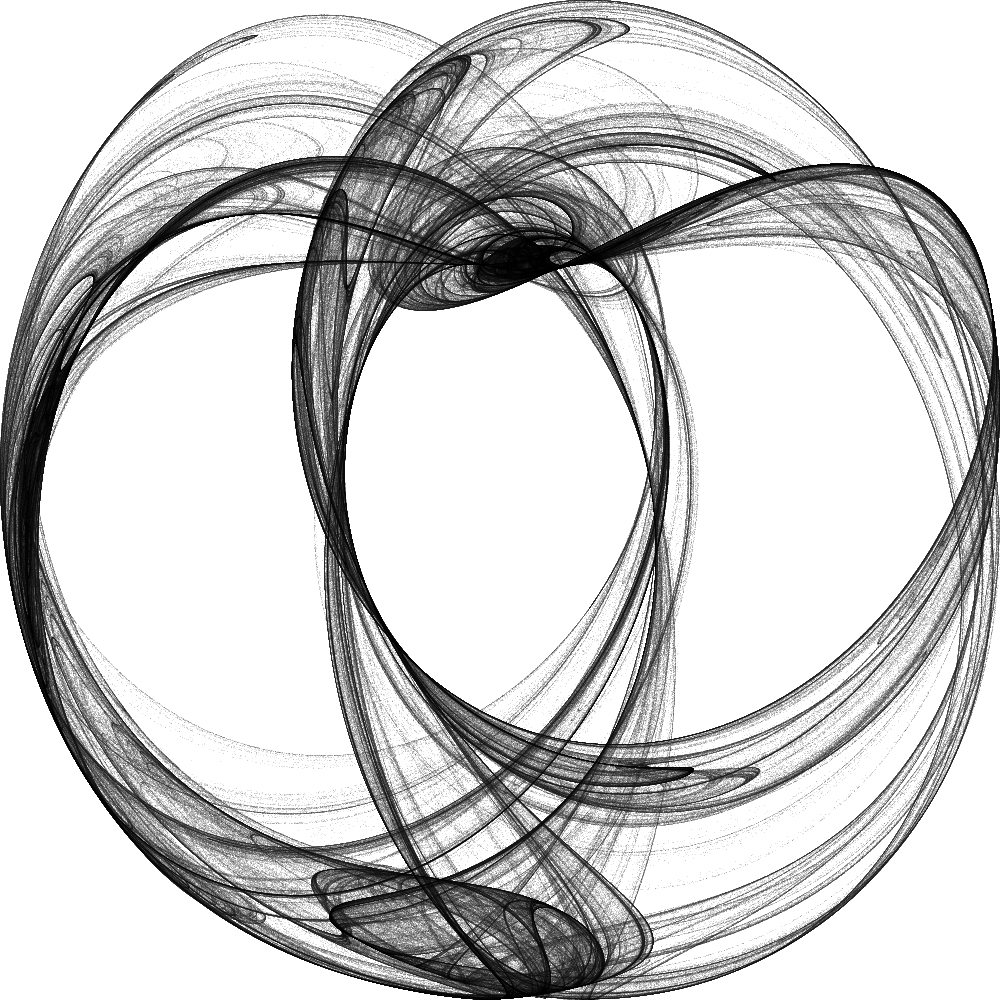
...
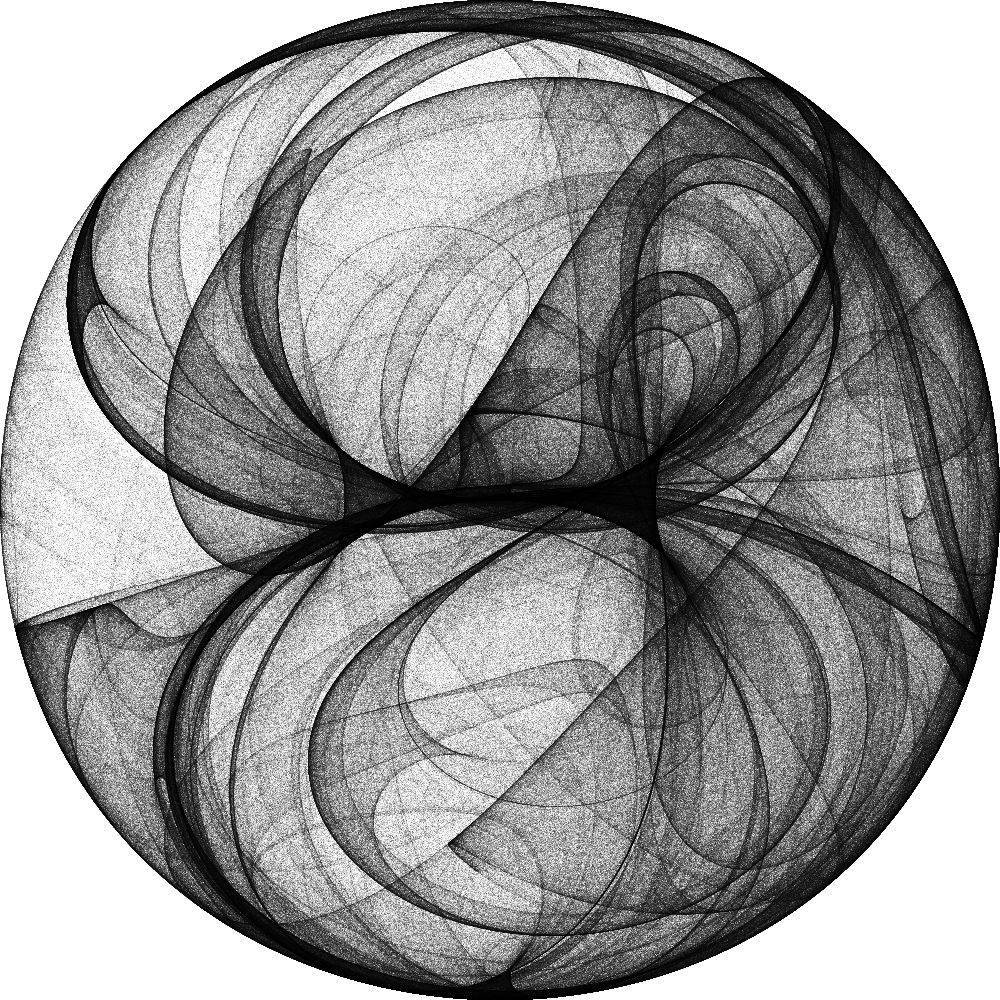
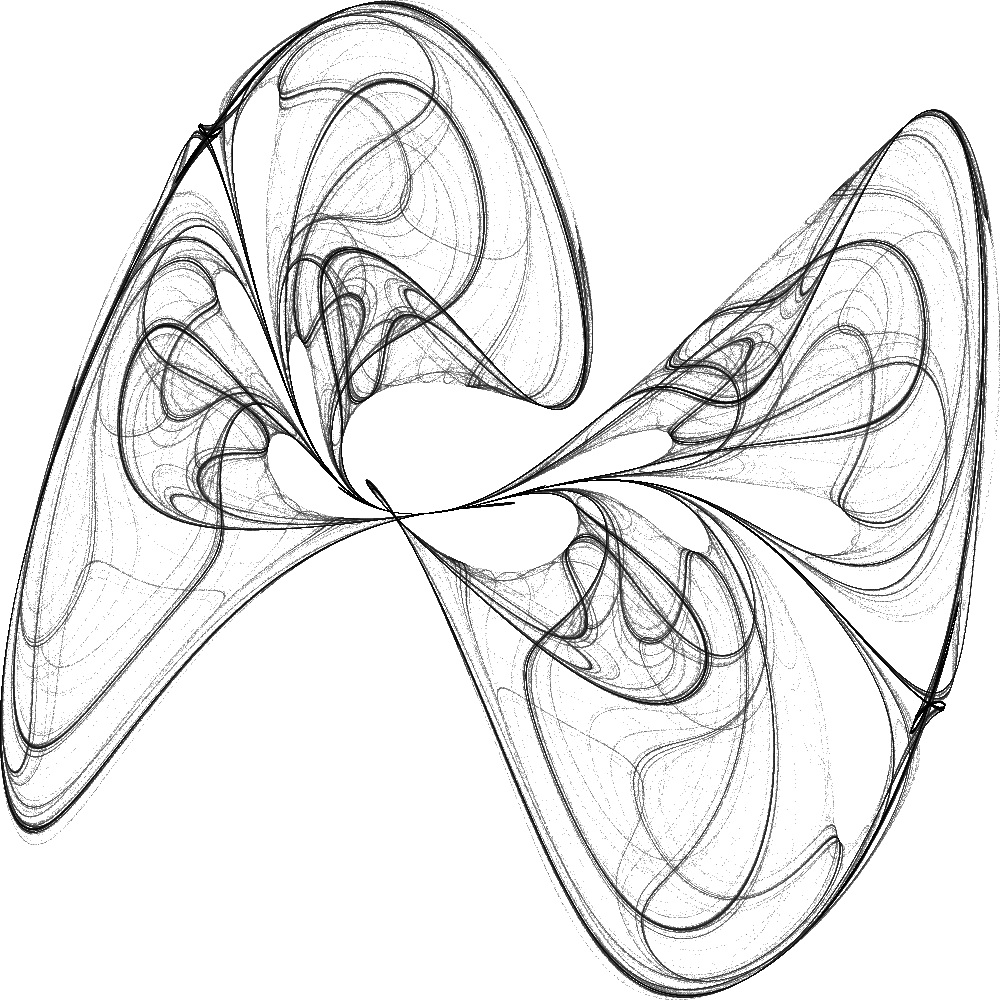
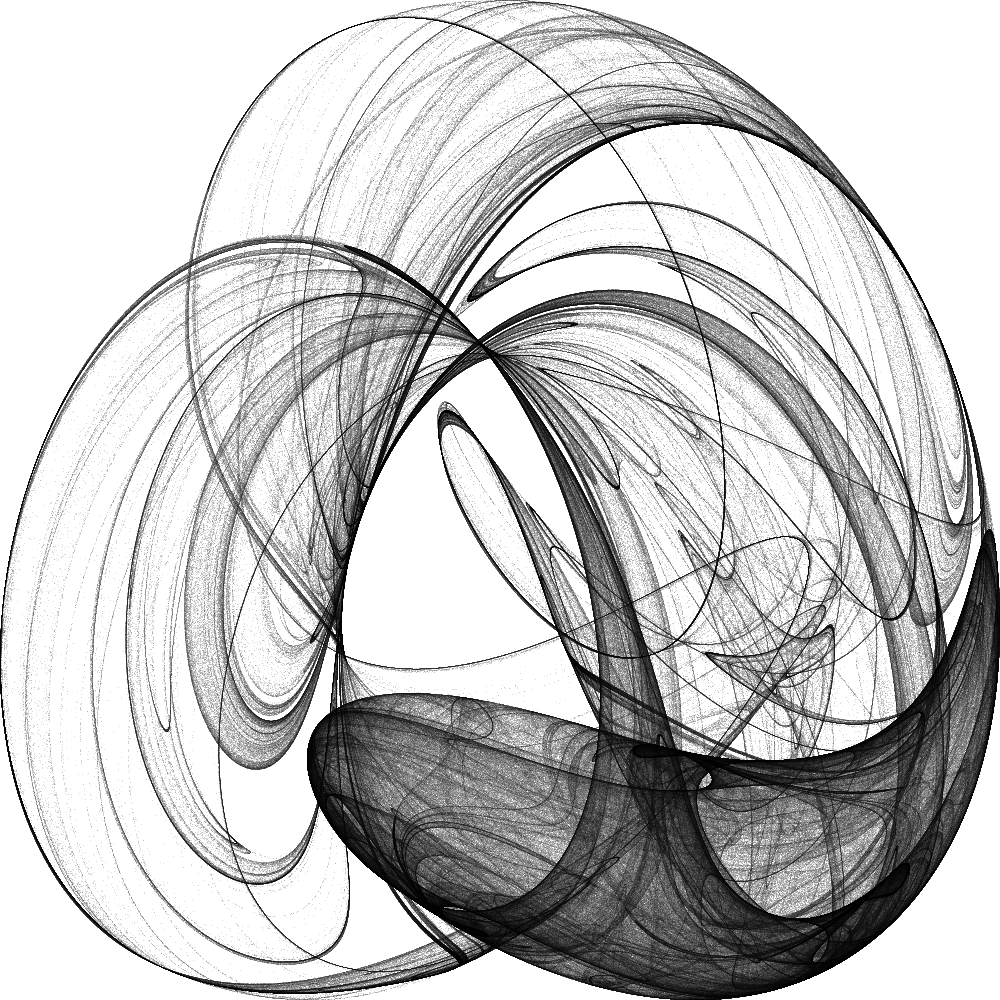
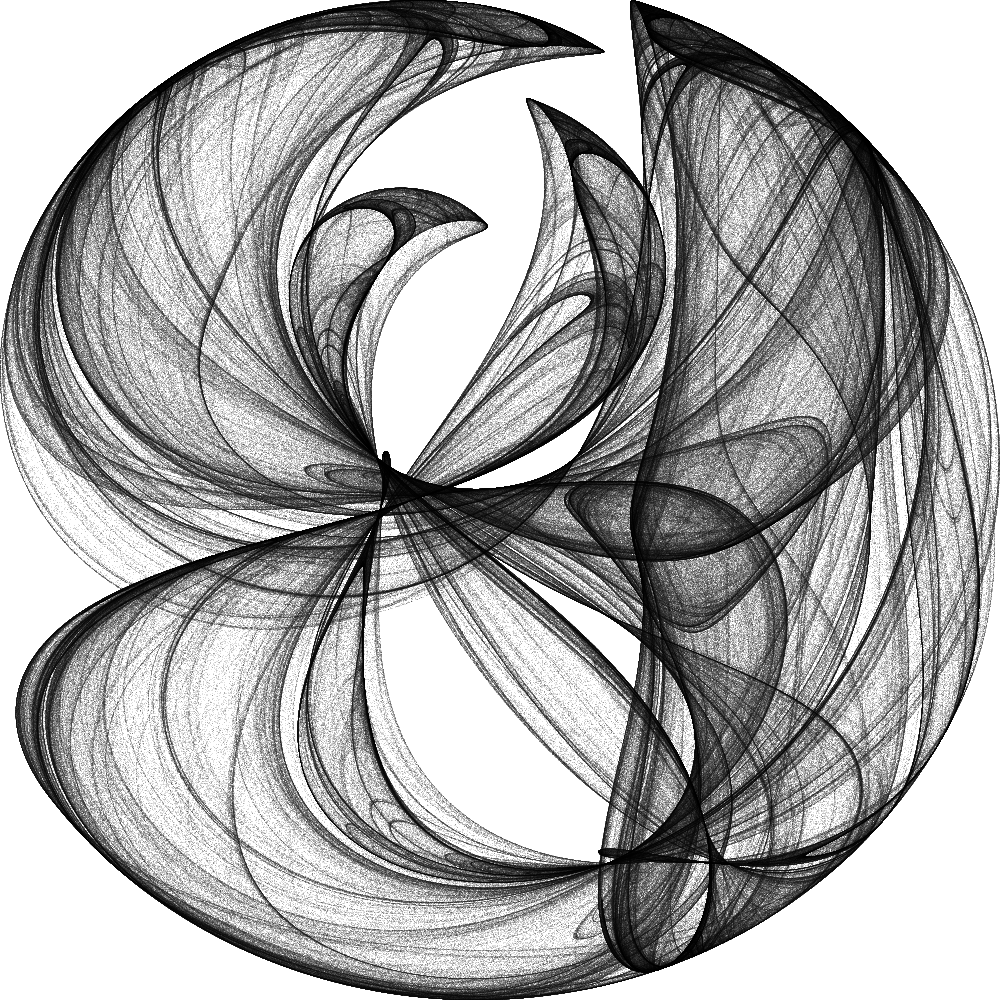
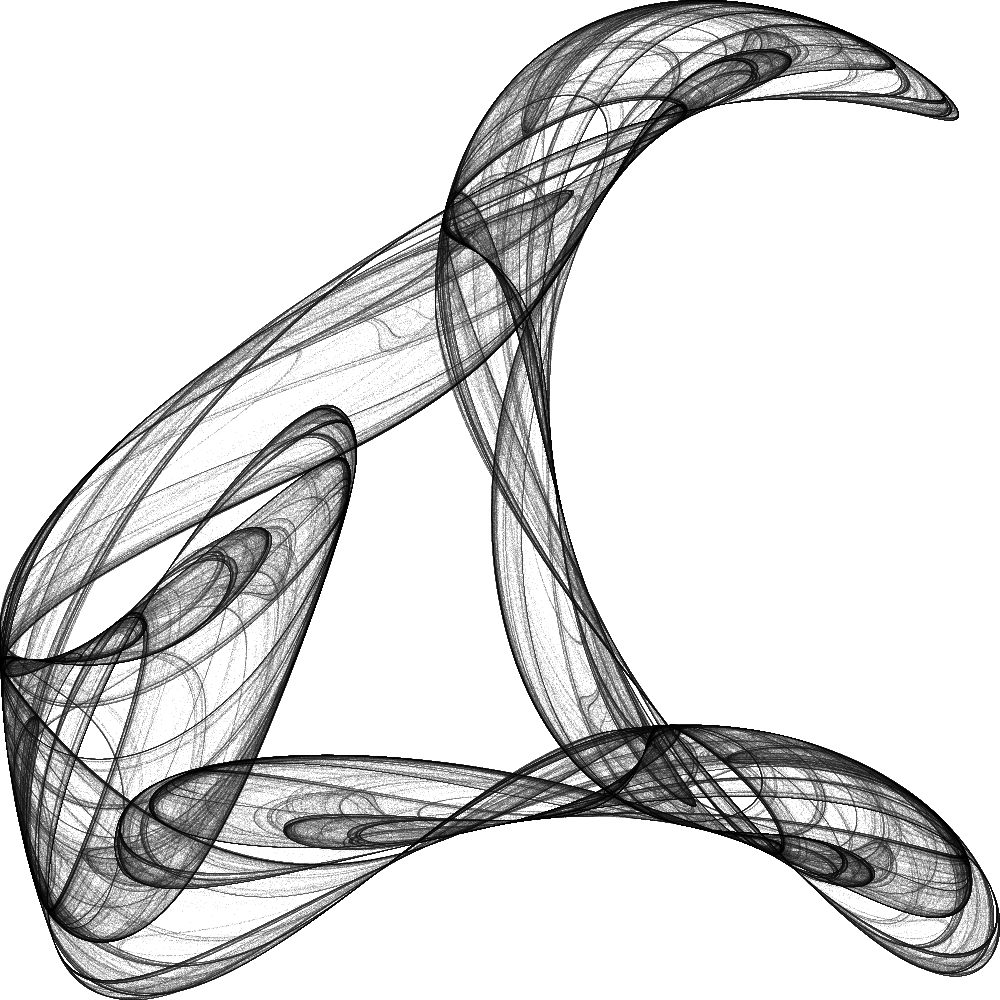

In [110]:
plot(Clifford)